# 3DNGMIC: A DATASET OF REAL AND GAN-GENERATED 3D MICROSCOPY IMAGES FOR NUCLEUS-GOLGI DETECTION, SEGMENTATION AND PAIRING

This notebook contains the instructions on how to visualize the dataset (in 2D and also in 3D), how to train and evaluate the Vox2Vox model for synthetic image generation, how to generate new data based on the trained Vox2Vox model, and how to train the centroid detection model with real and GAN-generated synthetic data.

### 1) Dataset Visualization (2D Projections)

#### Specify the directories

In [1]:
split_ = 'synthetic' # train, val, test, test_additional or synthetic
image_dir = '3DNGMic/' + split_ + '/outputs' #directory with the image subvolumes
vector_dir = '3DNGMic/' + split_ + '/vectors' #directory with the vector files
mask_dir = '3DNGMic/' + split_ + '/inputs' #directory with the segmentation subvolumes
heatmap_dir = '3DNGMic/' + split_ + '/heatmaps' #directory with the heatmaps

/home/jovyan/discotreino/Vox2Vox/utils/visualization.py:11: RuntimeWarning: invalid value encountered in true_divide
  mip_img = (((mip_img - minval) / (maxval - minval)) * 255).astype('uint8')
/home/jovyan/discotreino/Vox2Vox/utils/visualization.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  f, (ax1, ax2, ax3, ax4) = plt.subplots(1,4)


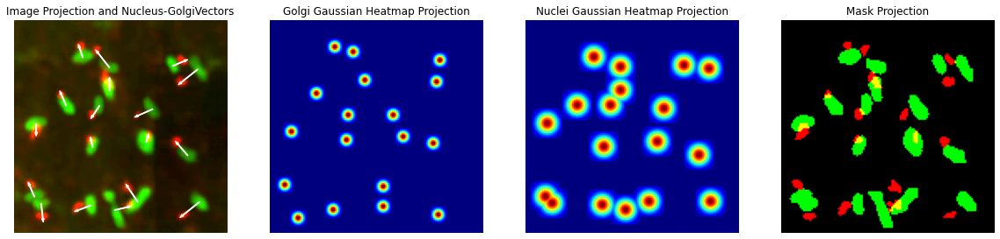

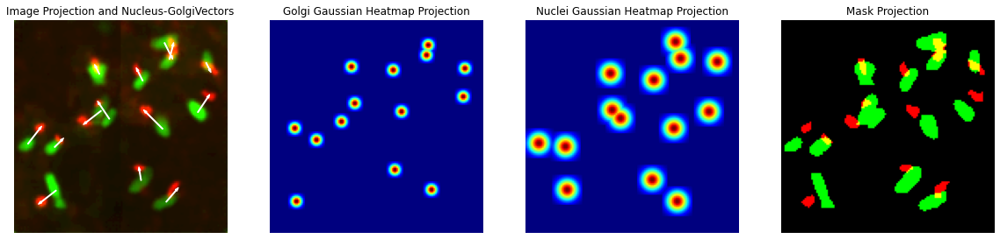

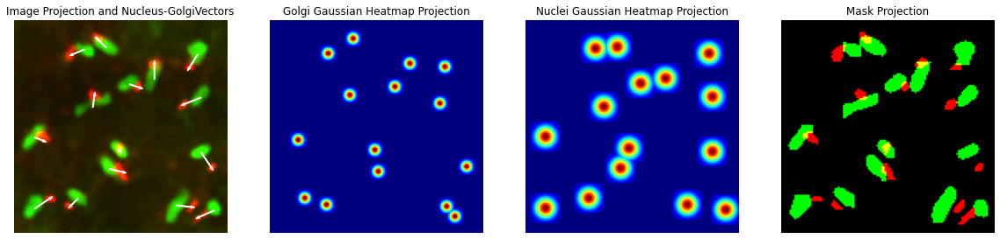

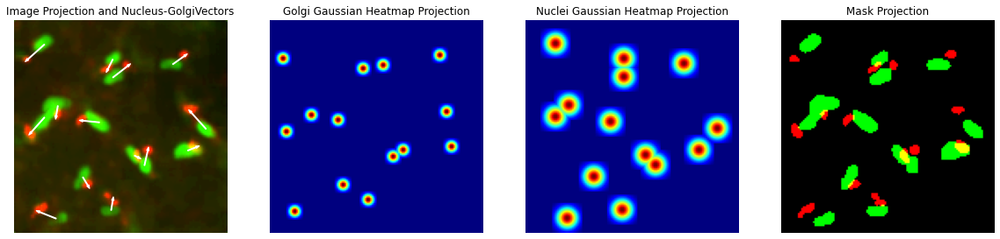

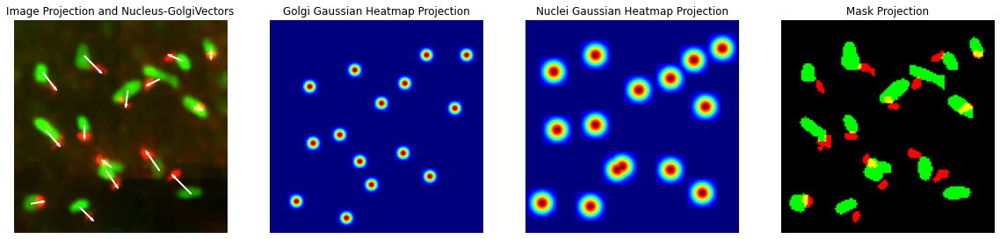

...

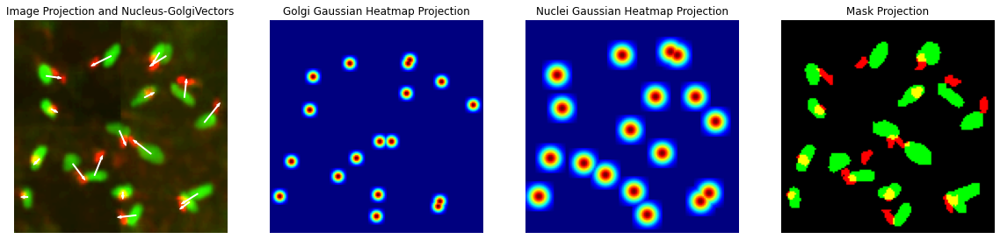

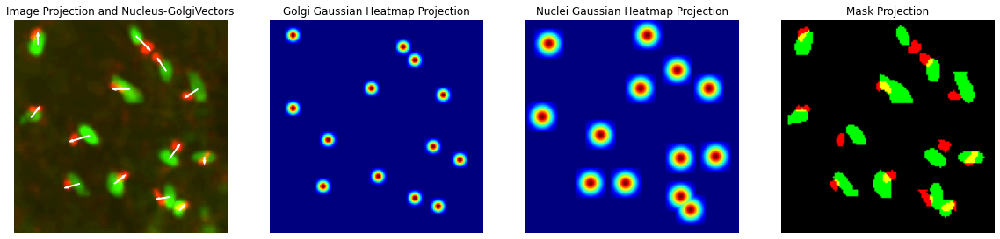

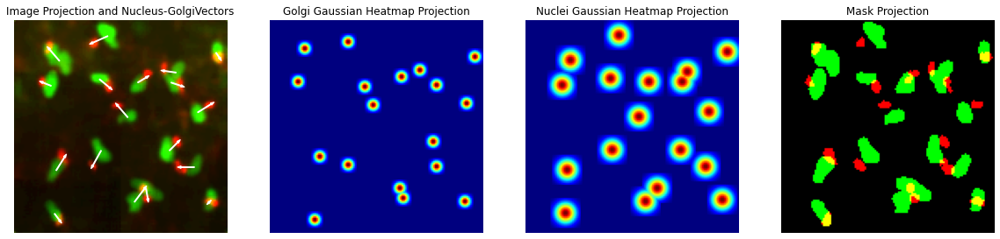

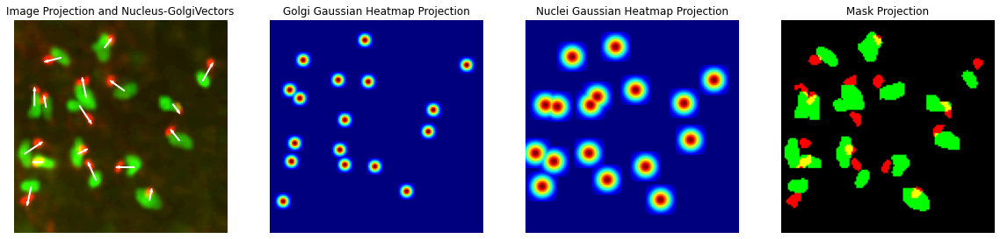

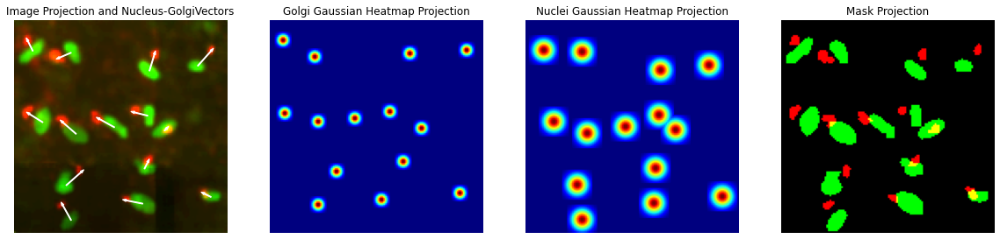

In [2]:
from utils.visualization import visualize_dataset_2d
visualize_dataset_2d(image_dir, mask_dir, heatmap_dir, vector_dir)

### 2) Dataset Visualization (3D)

#### To visualize the images and masks in 3D, convert them into .tif files and visualize using Imaris Viewer

In [2]:
from utils.conversion import *
dir_ = '3DNGMic/test/outputs' #directory with images or masks
save_dir = 'tif_visualization'  #directory where the .tif files will be saved
convert_npy_tif(dir_, save_dir)

### 3) Vox2Vox Model

#### To train the Vox2Vox model, specify the directories in the next cell and run the following cells

In [3]:
from utils.vox2vox_model import *

train_dir = '3DNGMic/train' #directory with the training set
val_dir = '3DNGMic/val' #directory with the validation set

In [ ]:
image_shape = (64, 128, 128, 2)

# define the discriminator and generator models
d_model = define_discriminator(image_shape)
g_model = define_generator(image_shape)

# define the composite model
gan_model = define_gan(g_model, d_model, image_shape)
#gan_model.summary()
# train the model
train(d_model, g_model, gan_model, image_shape, train_dir, val_dir, n_epochs=200, n_batch=2)

#### To test the Vox2Vox model, specify the directories in the next cell and run the cells

In [1]:
from utils.predict_synth import *

models_path = r'trained_model/model_vox2vox.h5' #trained model path
input_path = r'3DNGMic/test/inputs/' #test inputs (masks)
save_dir = r'results_test' #directory where the synthetic images will be saved

In [2]:
image_shape = (64,128,128,2)

predict(models_path, input_path, save_dir, image_shape)

Number of Test Samples: 44


2025-01-31 08:52:17.795914: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2025-01-31 08:52:17.801080: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2025-01-31 08:52:17.801354: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2025-01-31 08:52:17.802157: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags

Model Loaded


2025-01-31 08:52:18.988677: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:185] None of the MLIR Optimization Passes are enabled (registered 2)
2025-01-31 08:52:19.561729: I tensorflow/stream_executor/cuda/cuda_dnn.cc:369] Loaded cuDNN version 8101
2025-01-31 08:52:19.728952: I tensorflow/core/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2025-01-31 08:52:19.729278: I tensorflow/core/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2025-01-31 08:52:19.729314: W tensorflow/stream_executor/gpu/asm_compiler.cc:77] Couldn't get ptxas version string: Internal: Couldn't invoke ptxas --version
2025-01-31 08:52:19.729772: I tensorflow/core/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2025-01-31 08:52:19.729828: W tensorflow/stream_executor/gpu/redzone_allocator.cc:314] Internal: Failed to launch ptxas
Relying on driver to perform ptx co

In [3]:
from utils.evaluation import *
real_image_dir = r'3DNGMic/test/outputs/'
compute_SSIM(real_image_dir, save_dir)

mean SSIM SSIM    0.841993
dtype: float64


#### To generate synthetic images with new nuclei and Golgi configurations, specifiy the directories in the following cell and run the cells (make sure there is the folder named object_shapes with 4 files: nuclei_shapes.pkl, Golgi_shapes.pkl, nuclei_centroids.pkl, and Golgi_centroids.pkl)

In [1]:
from utils.new_data import *
save_dir_masks = r'3DNGMic/synthetic/inputs' #directory to save the synthetic masks
save_dir_vecs = r'3DNGMic/synthetic/vectors' #directory to save the synthetic vectors
save_dir_images = r'3DNGMic/synthetic/outputs' #directory to save the synthetic images
models_path = r'trained_model/model_vox2vox.h5' #trained model path
number_patches = 172 #How many new patches we want to generate
patch_numbers = np.arange(0,172)
inputs_generation(save_dir_masks, save_dir_vecs, number_patches)
predict(models_path, save_dir_masks, save_dir_images, patch_numbers)

2025-01-31 09:08:00.467924: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2025-01-31 09:08:00.473087: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2025-01-31 09:08:00.473357: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2025-01-31 09:08:00.474165: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags

2025-01-31 09:08:01.628827: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:185] None of the MLIR Optimization Passes are enabled (registered 2)
2025-01-31 09:08:02.203679: I tensorflow/stream_executor/cuda/cuda_dnn.cc:369] Loaded cuDNN version 8101
2025-01-31 09:08:02.370645: I tensorflow/core/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2025-01-31 09:08:02.371032: I tensorflow/core/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2025-01-31 09:08:02.371056: W tensorflow/stream_executor/gpu/asm_compiler.cc:77] Couldn't get ptxas version string: Internal: Couldn't invoke ptxas --version
2025-01-31 09:08:02.371487: I tensorflow/core/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2025-01-31 09:08:02.371544: W tensorflow/stream_executor/gpu/redzone_allocator.cc:314] Internal: Failed to launch ptxas
Relying on driver to perform ptx co

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
